# PART B - Conditional GAN

In this second half of the project we will construct a conditional generative adversarial network for our image colourization task.

GITHUB does not allow files larger than 25MB so this whole project is splitted into two notebooks. The part B code needs to be appended to the part A code to run properly.

## Part 1. Conditional GAN

We will be exploring the different architectures to identify and select our best image colourization model.


### Part (a)
Implement a generator and test to verify it works on the desired input (We will reuse some of the earlier autoencoder models here to act as a generator)

In [ ]:
gensizes=[]
class Generator(nn.Module):
    def __init__(self, kernel, num_filters, num_colours=3, num_in_channels=1):
        super().__init__()

        # Useful parameters
        stride = 2
        padding = kernel // 2
        output_padding = 1
        padding = kernel // 2

        self.downconv1 = nn.Sequential(
            nn.Conv2d(1, num_filters, kernel_size=kernel, padding=padding),
            nn.BatchNorm2d(num_filters),
            nn.LeakyReLU(0.2,inplace=True),
            nn.MaxPool2d(2),)
        self.downconv2 = nn.Sequential(
            nn.Conv2d(num_filters, num_filters*2, kernel_size=kernel, padding=padding),
            nn.BatchNorm2d(num_filters*2),
            nn.LeakyReLU(0.2,inplace=True),
            nn.MaxPool2d(2),)

        self.rfconv = nn.Sequential(
            nn.Conv2d(num_filters*2, num_filters*2, kernel_size=kernel, padding=padding),
            nn.BatchNorm2d(num_filters*2),
            nn.LeakyReLU(0.2,inplace=True))

        self.upconv1 = nn.Sequential(
            nn.Conv2d(num_filters*4, num_filters, kernel_size=kernel, padding=padding),
            nn.BatchNorm2d(num_filters),
            nn.LeakyReLU(0.2,inplace=True),
            nn.Upsample(scale_factor=2),)
        self.upconv2 = nn.Sequential(
            nn.Conv2d(num_filters*2, num_colours, kernel_size=kernel, padding=padding),
            nn.BatchNorm2d(3),
            nn.LeakyReLU(0.2,inplace=True),
            nn.Upsample(scale_factor=2),)
        self.finalconv = nn.Conv2d(num_colours+1, num_colours, kernel_size=kernel, padding=padding)

    def forward(self, x):
        global gensizes
        gensizes=[]
        gensizes.append(x.size())
        lay1 = self.downconv1(x)
        gensizes.append(lay1.size())
        lay2 = self.downconv2(lay1)
        gensizes.append(lay2.size())
        lay3 = self.rfconv(lay2)
        lay3=torch.cat((lay3,lay2),1)
        gensizes.append(lay3.size())
        lay4 = self.upconv1(lay3)
        lay4=torch.cat((lay4,lay1),1)
        gensizes.append(lay4.size())
        lay5 = self.upconv2(lay4)
        lay5=torch.cat((lay5,x),1)
        gensizes.append(lay5.size())
        out = self.finalconv(lay5)
        gensizes.append(out.size())
        return out

### Part (b)
Implement a discriminator and test to verify it works on the desired input.

In [ ]:
discsize=[]
class Discriminator(nn.Module): 
    def __init__(self, kernel, num_filters, num_colours=3, num_in_channels=1):
        super().__init__()
        
        # Useful parameters
        stride = 2
        padding = kernel // 2
        output_padding = 1
        self.num_filters=num_filters
        self.conv1=nn.Sequential( #in=6*32*32,out=16*16*16
            nn.Conv2d(num_colours+1,num_filters,kernel_size=kernel,padding=padding),
            nn.BatchNorm2d(num_filters),
            nn.LeakyReLU(0.2,inplace=True),
            nn.MaxPool2d(2),
            nn.Dropout(0.5),
        )
        self.conv2=nn.Sequential( #in=16*16*16,out=32*8*8
            nn.Conv2d(num_filters,num_filters*2,kernel_size=kernel,padding=padding),
            nn.BatchNorm2d(num_filters*2),
            nn.LeakyReLU(0.2,inplace=True),
            nn.MaxPool2d(2),
            nn.Dropout(0.5),
        )
        self.linear1=nn.Sequential(
            nn.Linear(num_filters*2*8*8,num_filters*4),
            nn.LeakyReLU(0.2,inplace=True),
            nn.Dropout(0.5),)
        self.linear2=nn.Sequential(
            nn.Linear(num_filters*4,1),
            nn.Sigmoid(),)
    
    def forward(self, x, img):
        global discsize
        discsize=[]
        c=torch.cat((x,img),1)
        discsize.append(c.shape)
        lay1=self.conv1(c)
        discsize.append(lay1.shape)
        lay2=self.conv2(lay1)
        discsize.append(lay2.shape)
        lay3=lay2.view(-1,self.num_filters*2*8*8)
        lay3=self.linear1(lay3)
        discsize.append(lay3.shape)
        out=self.linear2(lay3)
        discsize.append(out.shape)
        return out

In [ ]:
#test the generator
trygen=Generator(3,16)
rt=torch.rand([2,1,32,32])
grt=trygen(rt)
grt.shape #should give [2,3,32,32]

torch.Size([2, 3, 32, 32])

In [ ]:
#test the discriminator
trydisc=Discriminator(3,16)
rt1=torch.rand([2,3,32,32]).float()
rt2=torch.rand([2,1,32,32]).float()
trydisc(rt1,rt2) #should give two float values

tensor([[0.4297],
        [0.4976]], grad_fn=<SigmoidBackward0>)

### Part (c) 
Modify the provided training code to implement a conditional GAN.

In [ ]:
(x_train, y_train), (x_test, y_test) = load_cifar10()
train_rgb, train_grey = process(x_train, y_train, downsize_input=False)
test_rgb, test_grey = process(x_test, y_test, downsize_input=False)
for i, (xs, ys) in enumerate(get_batch(train_grey, train_rgb, 2)):
            images, labels = get_torch_vars(xs, ys, True)
            print(images.shape)
            break

File path: data/cifar-10-batches-py.tar.gz
torch.Size([2, 1, 32, 32])


In [ ]:
train_grey.shape

(5000, 1, 32, 32)

In [ ]:
class AttrDict(dict):
    def __init__(self, *args, **kwargs):
        super(AttrDict, self).__init__(*args, **kwargs)
        self.__dict__ = self

def get_torch_vars(xs, ys, gpu=False):
    """
    Helper function to convert numpy arrays to pytorch tensors.
    If GPU is used, move the tensors to GPU.

    Args:
      xs (float numpy tenosor): greyscale input
      ys (int numpy tenosor): categorical labels
      gpu (bool): whether to move pytorch tensor to GPU
    Returns:
      Variable(xs), Variable(ys)
    """
    xs = torch.from_numpy(xs).float()
    ys = torch.from_numpy(ys).float() #--> ADDED for cGAN
    if gpu:
      try:
        xs = xs.cuda()
        ys = ys.cuda()
      except:
        print('No CUDA GPUs are available')
    return Variable(xs), Variable(ys)

def train(args, cnn=None,train_grey=train_grey,train_rgb=train_rgb):
    # Set the maximum number of threads to prevent crash in Teaching Labs
    # TODO: necessary?
    torch.set_num_threads(5)
    # Numpy random seed
    npr.seed(args.seed)

    # Save directory
    save_dir = "outputs/" + args.experiment_name

    # LOAD THE COLOURS CATEGORIES

    # INPUT CHANNEL
    num_in_channels = 1 if not args.downsize_input else 3
    # LOAD THE MODEL
    if cnn is None:
        Net = globals()[args.model]
        cnn = Net(args.kernel,args.num_filters)
        discriminator = Discriminator(args.kernel,args.num_filters,num_colours=args.num_colours)


    # LOSS FUNCTION

    criterion =  nn.BCELoss()                                                   
    g_optimizer = torch.optim.Adam(cnn.parameters(), lr=args.learn_rate)
    d_optimizer = torch.optim.Adam(discriminator.parameters(), lr=args.learn_rate/args.learn_rate_ratio)

    # DATA
    print("Loading data...")
    #(x_train, y_train), (x_test, y_test) = load_cifar10()

    print("Transforming data...")
    #train_rgb, train_grey = process(x_train, y_train, downsize_input=args.downsize_input)
    #test_rgb, test_grey = process(x_test, y_test, downsize_input=args.downsize_input)

    # Create the outputs folder if not created already    
    print('will create the outputs folder...')
    if not os.path.exists(save_dir):
        print('Create the outputs folder...')
        os.makedirs(save_dir)

    print("Beginning training ...")
    if args.gpu:
      try:
        cnn.cuda()
        discriminator.cuda()
      except:
        print('No CUDA GPUs are available')
    start = time.time()

    train_losses = []
    valid_losses = []
    valid_accs = []
    for epoch in range(args.epochs):
        # Train the Model
        cnn.train()
        discriminator.train()
        losses = []
 
        for i, (xs, ys) in enumerate(get_batch(train_grey, train_rgb, args.batch_size)):
            images, labels = get_torch_vars(xs, ys, args.gpu)

            #--->ADDED 5
            img_grey = images
            img_real = labels
            batch_size = args.batch_size
            
            #discriminator training
            d_optimizer.zero_grad()
            #print(img_real.shape)
            d_real=discriminator(img_real,img_grey)
            real_labels=torch.from_numpy(np.zeros(img_grey.shape[0])).float()
            if args.gpu:
                try:
                    real_labels=real_labels.cuda()
                except:
                    pass
            #print('d_real shape:',d_real.shape[0])  
            #print('real_labels shape:',real_labels.shape)
            d_loss_real=criterion(d_real.squeeze(),real_labels)
            img_fake=cnn(img_grey)
            #print(img_fake.shape)
            d_fake=discriminator(img_fake,img_grey)
            fake_labels=torch.ones(img_grey.shape[0]).float()
            #print('d_fake shape:',d_fake.shape)  
            #print('fake_labels shape:',fake_labels.shape)         
            if args.gpu:
                try:
                    fake_labels=fake_labels.cuda()
                except:
                    pass
            d_loss_fake=criterion(d_fake.squeeze(),fake_labels)
            d_loss=d_loss_fake+d_loss_real
            d_loss.backward()
            d_optimizer.step()

            # generator training
            g_optimizer.zero_grad()
            img_gen=cnn(img_grey)
            if args.gpu:
                try:
                    img_gen=img_gen.cuda()
                except:
                    pass
            validity=discriminator(img_gen,img_grey)
            actual_labels=torch.zeros(img_grey.shape[0])
            if args.gpu:
                try:
                    actual_labels=actual_labels.cuda()
                except:
                    pass
            g_loss=criterion(validity.squeeze(),actual_labels)

            g_loss.backward()
            g_optimizer.step()


        # print and visualize
        print(epoch, g_loss.cpu().detach(), d_loss.cpu().detach())
        if args.num_colours==3:
          visual(images, labels, img_fake, args.gpu, 1)
        elif args.num_colours==2:
          visualLab(images, labels, img_fake,args.gpu)

    return cnn

### Part (d)
Train a conditional GAN for image colourization.

Loading data...
Transforming data...
will create the outputs folder...
Beginning training ...


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


0 tensor(1.6192) tensor(0.9227)


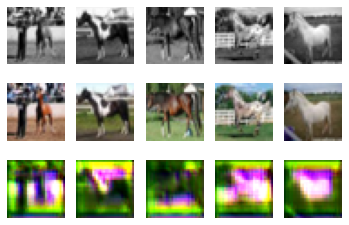

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1 tensor(2.0793) tensor(0.6355)


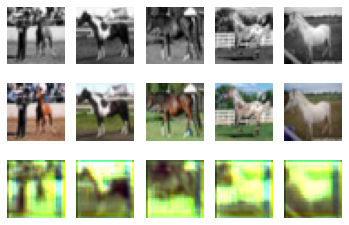

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2 tensor(1.2455) tensor(1.1667)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


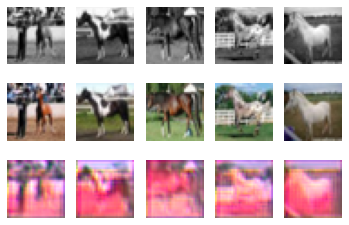

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3 tensor(2.1410) tensor(0.6321)


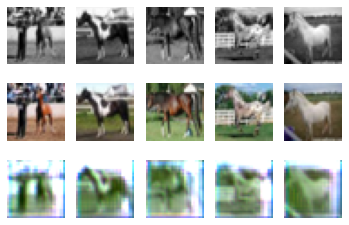

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


4 tensor(2.1523) tensor(0.5774)


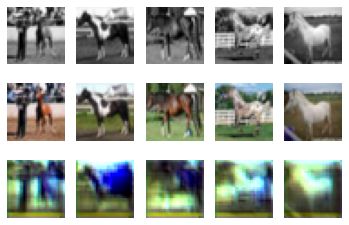

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


5 tensor(1.3785) tensor(1.2489)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


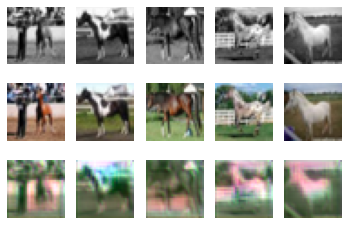

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


6 tensor(0.9599) tensor(1.1182)


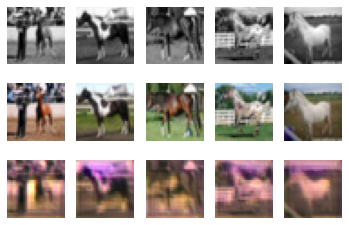

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


7 tensor(1.5924) tensor(1.0213)


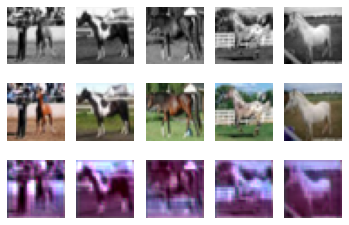

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


8 tensor(1.2234) tensor(1.0590)


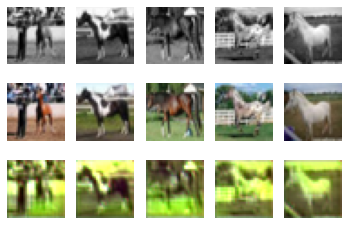

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


9 tensor(1.9378) tensor(0.8379)


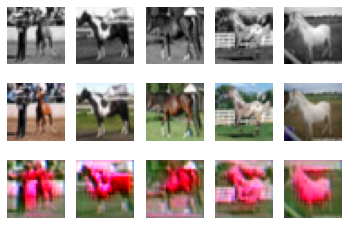

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


10 tensor(1.9202) tensor(0.8453)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


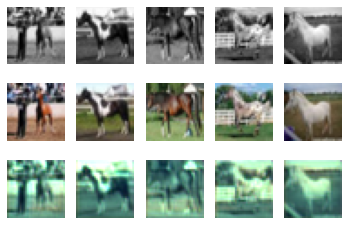

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


11 tensor(1.1232) tensor(1.2021)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


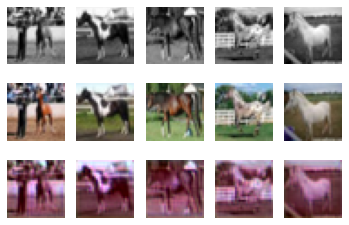

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


12 tensor(1.2278) tensor(1.2938)


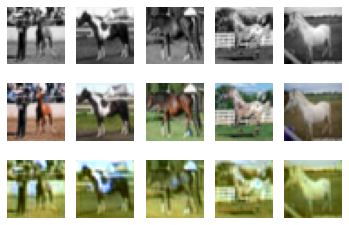

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


13 tensor(1.3671) tensor(1.0318)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


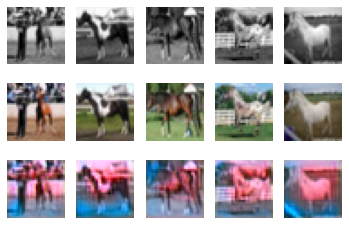

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


14 tensor(1.4219) tensor(1.1789)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


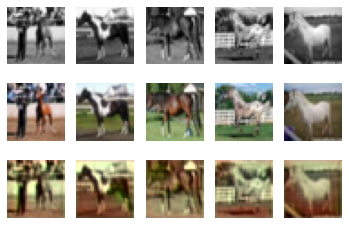

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


15 tensor(1.4426) tensor(0.8897)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


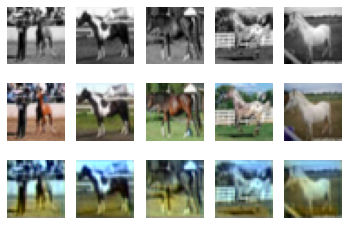

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


16 tensor(0.8902) tensor(1.4392)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


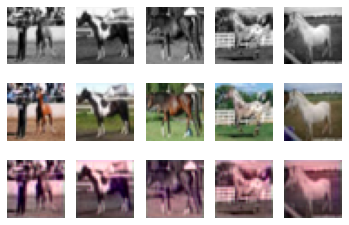

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


17 tensor(0.9127) tensor(1.2842)


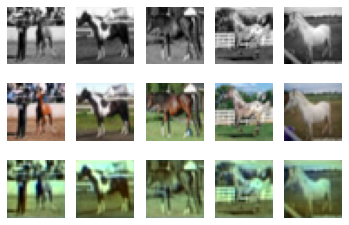

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


18 tensor(1.0772) tensor(1.1738)


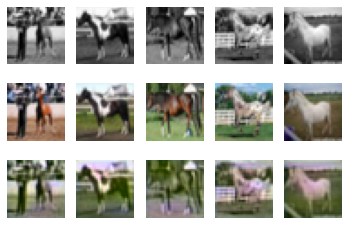

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


19 tensor(1.0291) tensor(1.1376)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


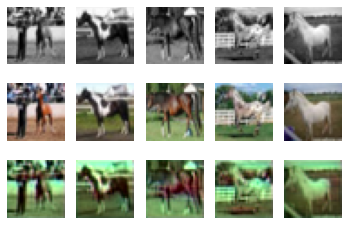

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


20 tensor(1.0632) tensor(1.1348)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


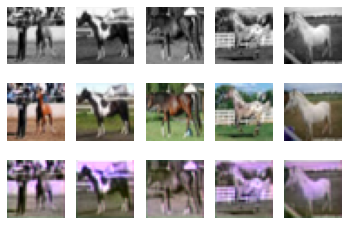

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


21 tensor(1.0959) tensor(1.1650)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


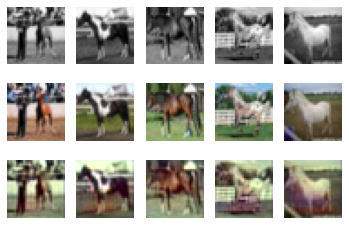

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


22 tensor(1.0444) tensor(1.4342)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


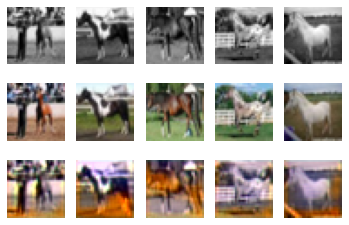

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


23 tensor(1.3659) tensor(1.0649)


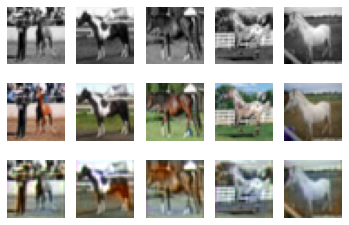

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


24 tensor(0.8357) tensor(1.5417)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


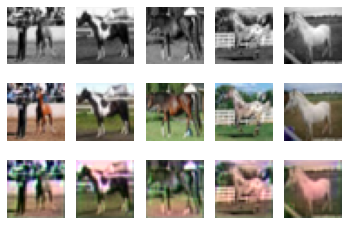

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


25 tensor(1.1155) tensor(1.0550)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


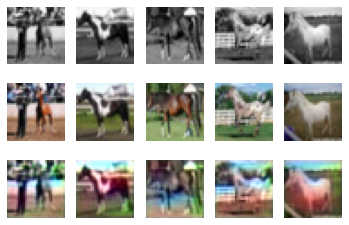

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


26 tensor(0.8872) tensor(1.2411)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


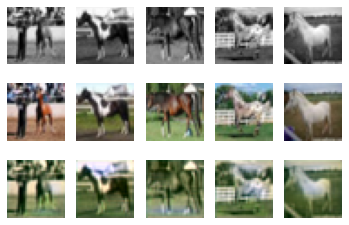

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


27 tensor(1.3031) tensor(1.1464)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


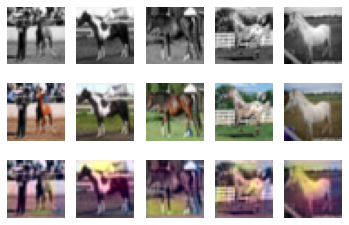

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


28 tensor(1.2962) tensor(1.3005)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


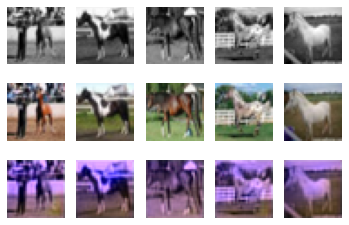

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


29 tensor(1.3794) tensor(0.9318)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


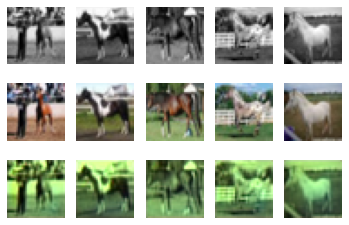

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


30 tensor(1.3163) tensor(0.9103)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


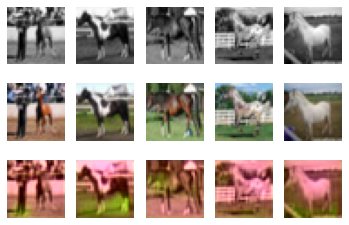

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


31 tensor(1.2321) tensor(1.0792)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


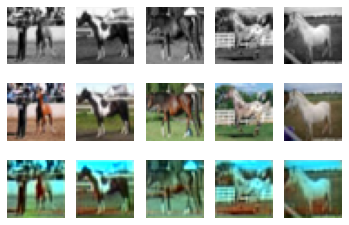

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


32 tensor(1.0693) tensor(1.2505)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


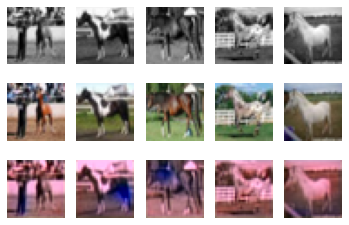

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


33 tensor(1.2663) tensor(1.1124)


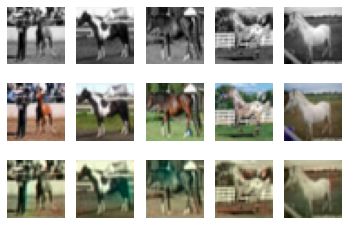

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


34 tensor(0.8207) tensor(1.7899)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


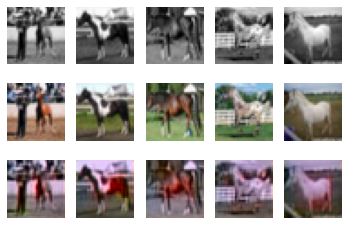

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


35 tensor(0.9514) tensor(1.3391)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


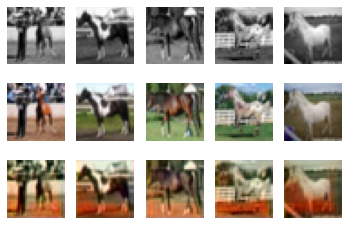

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


36 tensor(1.0112) tensor(1.1526)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


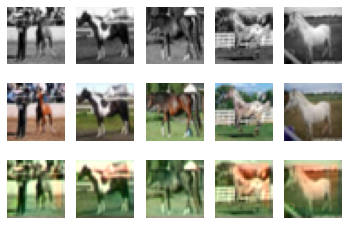

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


37 tensor(1.5371) tensor(0.9203)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


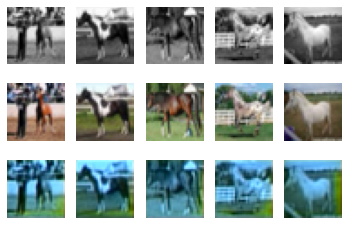

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


38 tensor(1.3506) tensor(0.8810)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


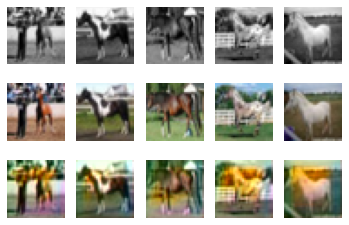

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


39 tensor(1.4074) tensor(0.8792)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


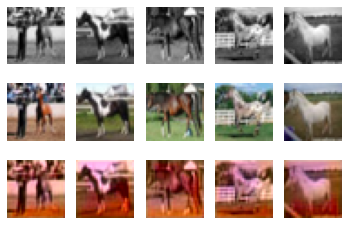

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


40 tensor(1.2158) tensor(1.0183)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


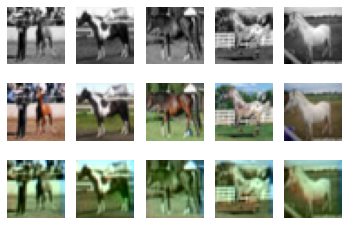

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


41 tensor(1.2539) tensor(0.8991)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


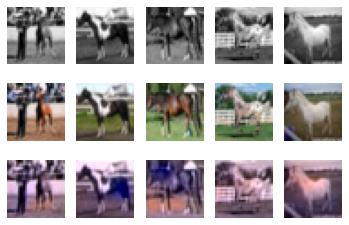

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


42 tensor(1.7734) tensor(0.8524)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


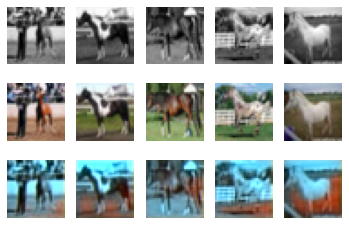

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


43 tensor(1.4333) tensor(0.8285)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


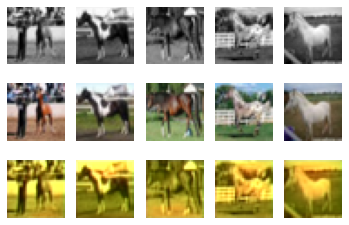

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


44 tensor(1.6627) tensor(0.8019)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


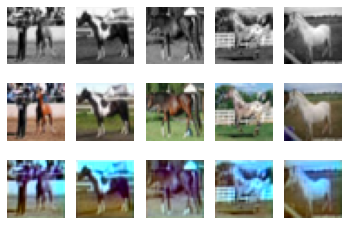

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


45 tensor(1.2865) tensor(0.9986)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


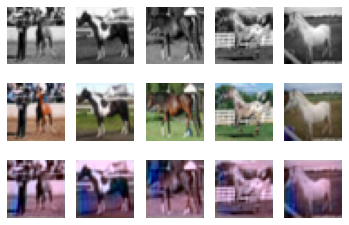

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


46 tensor(1.8097) tensor(0.6664)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


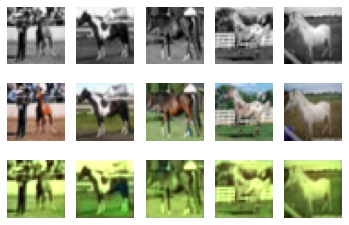

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


47 tensor(1.6089) tensor(0.8013)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


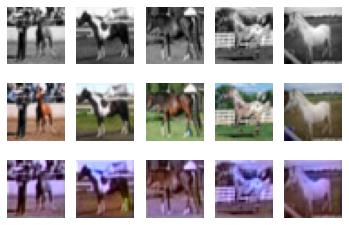

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


48 tensor(1.5292) tensor(1.1058)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


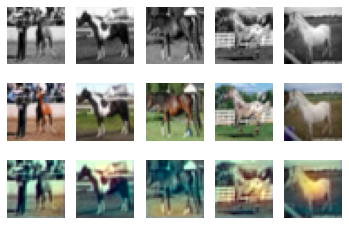

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


49 tensor(1.9014) tensor(0.7635)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


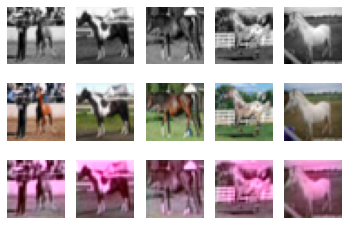

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


50 tensor(1.6702) tensor(0.6787)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


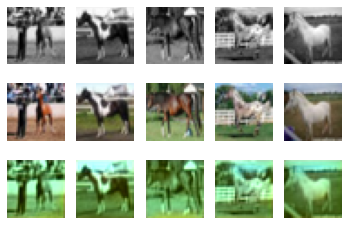

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


51 tensor(1.7855) tensor(1.1623)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


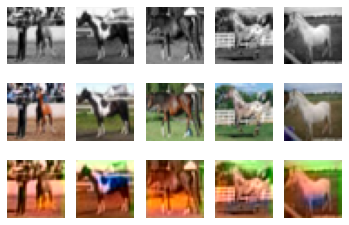

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


52 tensor(1.2868) tensor(1.1724)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


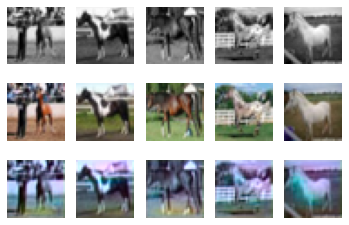

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


53 tensor(1.1277) tensor(1.0866)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


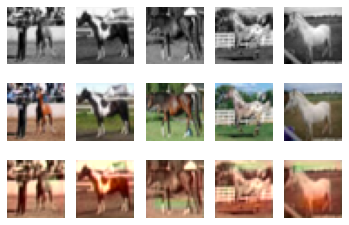

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


54 tensor(1.8053) tensor(0.9627)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


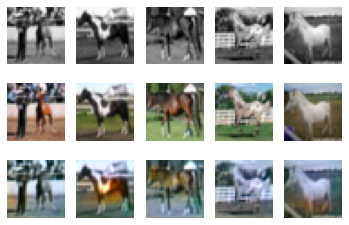

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


55 tensor(1.1910) tensor(1.0485)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


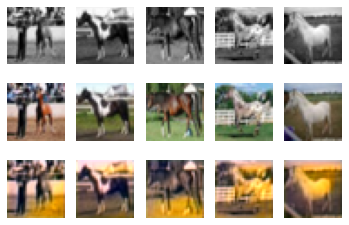

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


56 tensor(0.9861) tensor(1.3720)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


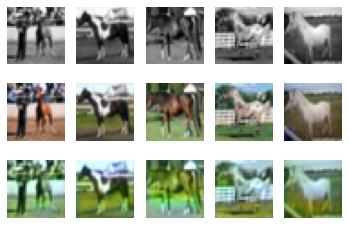

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


57 tensor(1.0966) tensor(1.2600)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


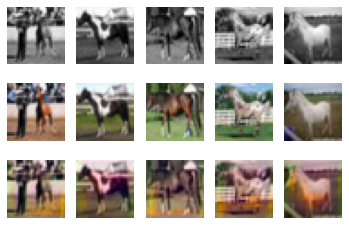

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


58 tensor(1.7147) tensor(0.6732)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


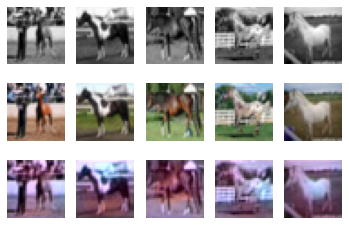

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


59 tensor(1.5258) tensor(0.7374)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


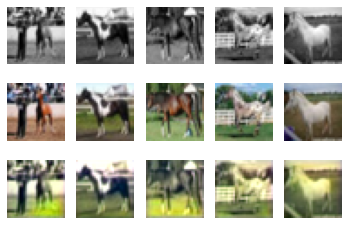

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


60 tensor(1.0422) tensor(1.1306)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


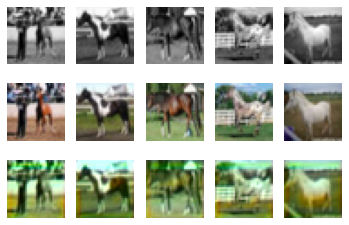

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


61 tensor(1.3529) tensor(1.1056)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


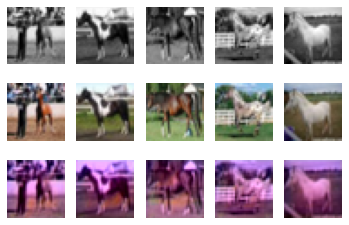

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


62 tensor(1.5892) tensor(0.6450)


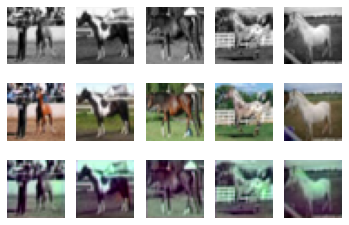

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


63 tensor(1.7670) tensor(0.9630)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


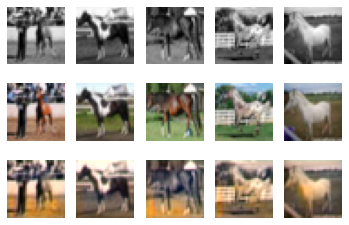

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


64 tensor(1.5793) tensor(0.8738)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


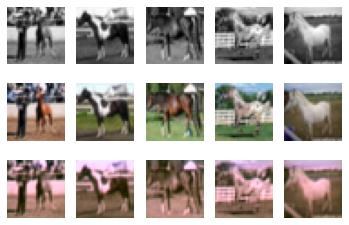

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


65 tensor(1.5017) tensor(0.8188)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


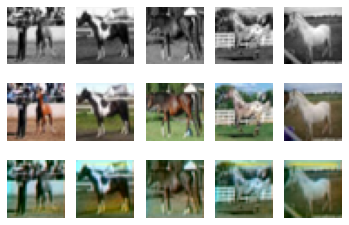

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


66 tensor(1.6711) tensor(1.0647)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


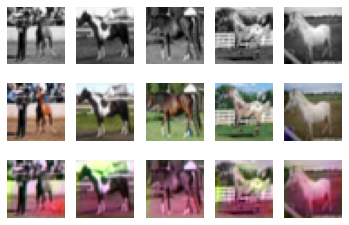

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


67 tensor(1.5534) tensor(0.9157)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


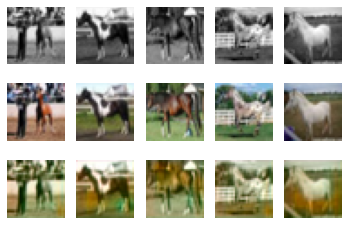

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


68 tensor(2.3213) tensor(0.4915)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


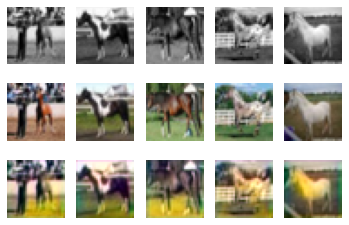

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


69 tensor(2.2616) tensor(0.3999)


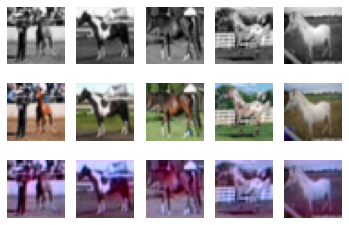

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


70 tensor(2.1097) tensor(0.5149)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


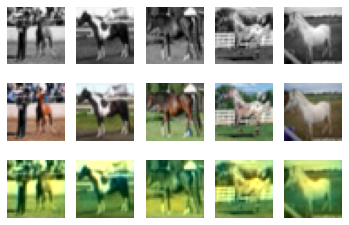

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


71 tensor(1.8620) tensor(0.7970)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


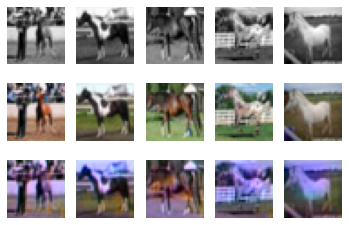

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


72 tensor(1.9491) tensor(0.6355)


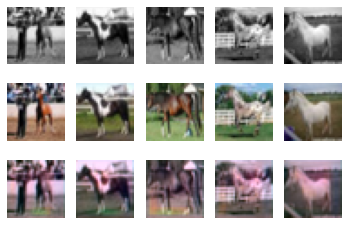

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


73 tensor(1.3586) tensor(0.9440)


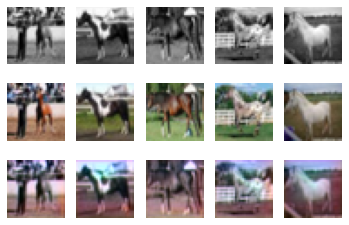

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


74 tensor(1.6788) tensor(0.9773)


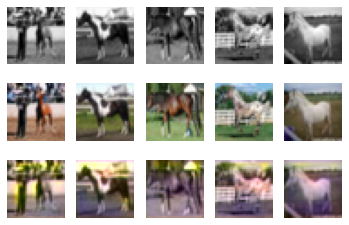

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


75 tensor(1.4288) tensor(0.9749)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


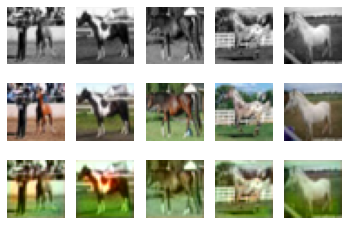

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


76 tensor(1.6504) tensor(0.7960)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


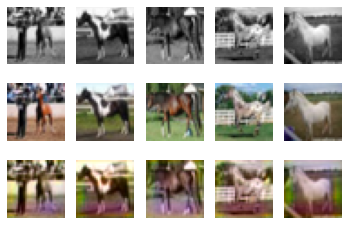

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


77 tensor(1.9241) tensor(0.6315)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


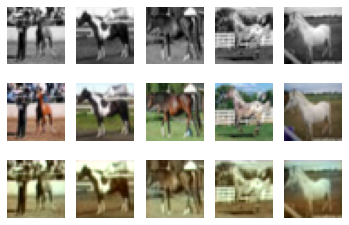

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


78 tensor(1.3308) tensor(1.2249)


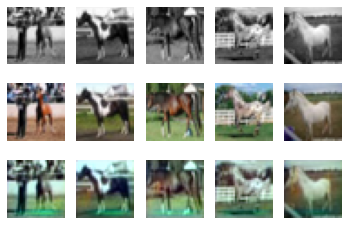

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


79 tensor(1.5071) tensor(0.9156)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


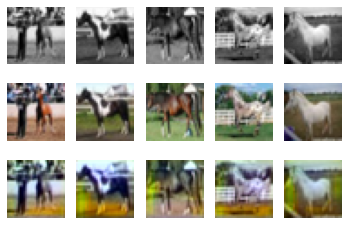

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


80 tensor(1.1532) tensor(1.1346)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


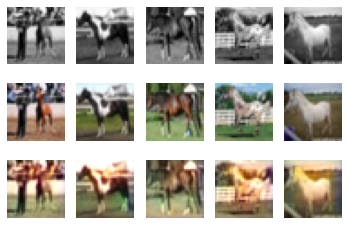

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


81 tensor(1.1533) tensor(1.4539)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


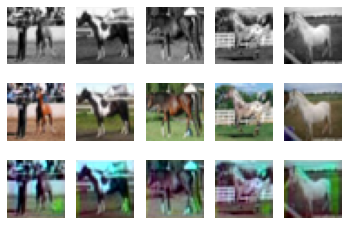

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


82 tensor(1.9628) tensor(0.4407)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


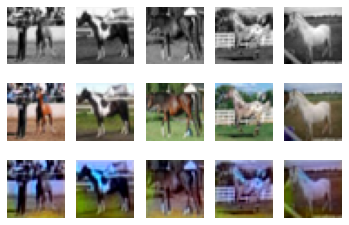

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


83 tensor(1.2477) tensor(0.8514)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


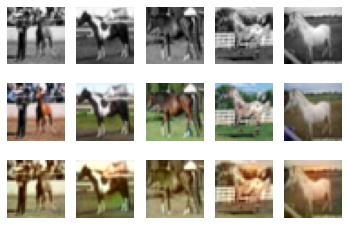

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


84 tensor(1.9796) tensor(0.5660)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


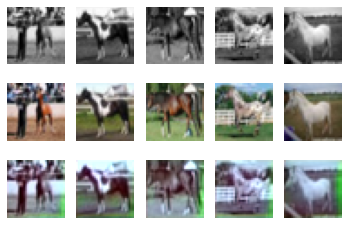

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


85 tensor(1.5013) tensor(1.0878)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


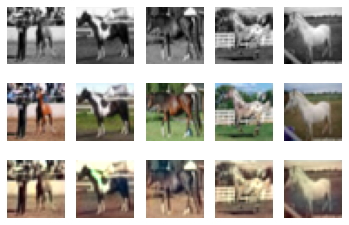

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


86 tensor(1.9787) tensor(0.7074)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


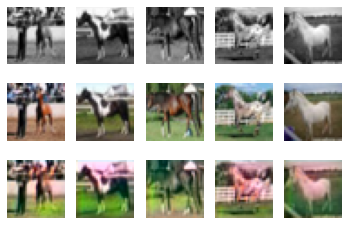

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


87 tensor(1.5952) tensor(1.0581)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


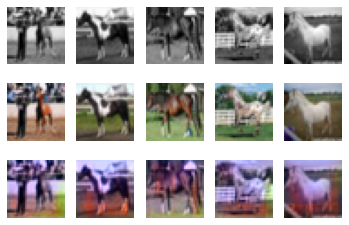

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


88 tensor(1.5756) tensor(0.7672)


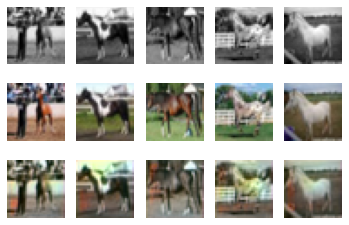

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


89 tensor(1.6980) tensor(0.7482)


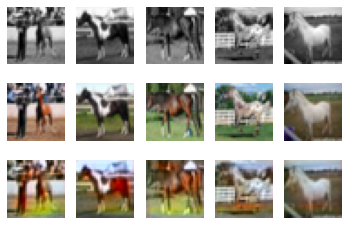

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


90 tensor(1.2862) tensor(0.9787)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


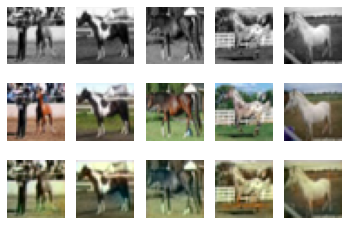

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


91 tensor(1.2064) tensor(1.4476)


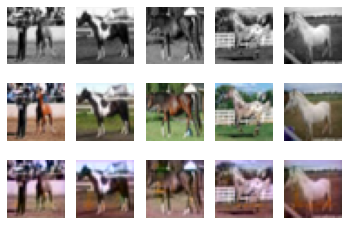

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


92 tensor(1.2357) tensor(1.1192)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


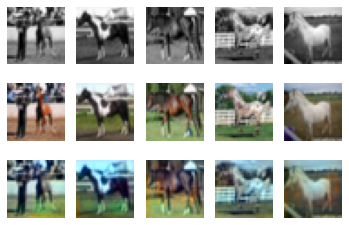

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


93 tensor(1.6033) tensor(0.7216)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


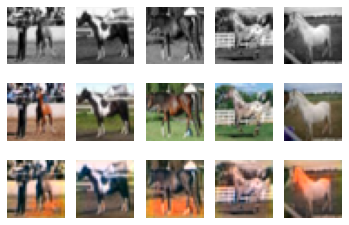

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


94 tensor(1.8880) tensor(0.7929)


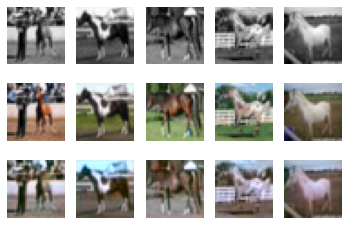

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


95 tensor(1.3700) tensor(1.3083)


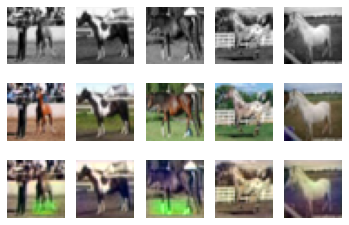

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


96 tensor(1.6576) tensor(0.6624)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


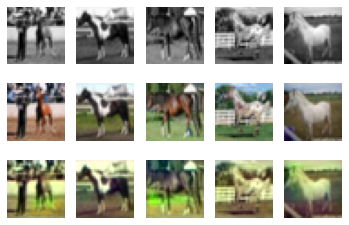

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


97 tensor(1.4856) tensor(0.7845)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


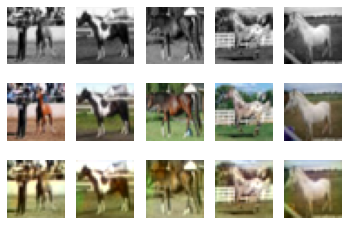

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


98 tensor(1.2947) tensor(1.2758)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


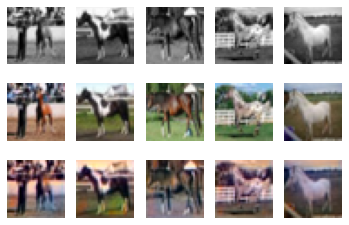

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


99 tensor(1.3414) tensor(0.9906)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


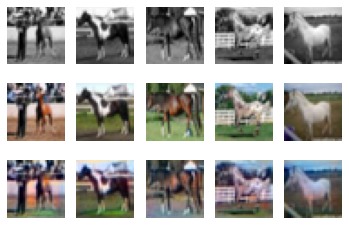

In [ ]:
#CUDA_LAUNCH_BLOCKING=1 python script.py
args = AttrDict()
args_dict = {
    "gpu": True,
    "valid": False,
    "checkpoint": "",
    "colours": "./data/colours/colour_kmeans24_cat7.npy",
    "num_colours":3,
    "model": "Generator",
    "kernel": 3,
    "num_filters": 32,
    'learn_rate':0.001,
    'learn_rate_ratio':5, 
    "batch_size": 100,
    "epochs": 100,
    "seed": 0,
    "plot": False,
    "experiment_name": "colourization_cnn",
    "visualize": False,
    "downsize_input": False,
}
args.update(args_dict)
cnn = train(args)

#batch size of 50 with 100 epochs seamed to work

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


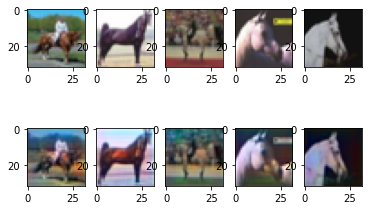

In [ ]:
#test on test data
testdexs=np.random.randint(1000,size=5)
tests=torch.from_numpy(test_grey)[testdexs,:,:,:].float().cuda()
preds=cnn(tests)
for i in range(preds.size()[0]):
  predimg=preds[i,:,:,:].squeeze().detach().cpu().numpy()
  predimg=predimg.transpose(1,2,0)
  plt.subplot(2,preds.size()[0],i+1+preds.size()[0])
  plt.imshow(predimg)
  origimg=test_rgb[testdexs[i],:,:,:].squeeze()
  origimg=origimg.transpose(1,2,0)
  plt.subplot(2,preds.size()[0],i+1)
  plt.imshow(origimg)

### Part (e) 

The cGAN model takes much more epochs of training before giving a useful result. The performance of the cGAN is better than autoencoders without skip connection, but is not as good as the UNet with skip connection. The sharpness of the cGAN colored images do not decrease, but the colors are not as accurately reproduced as the UNet.

### Part (f) 

A colour space is a choice of mapping of colours into three-dimensional coordinates. Some colours could be close together in one colour space, but further apart in others. The model used in our regression colourization example computes squared error in RGB colour space. But, most state of the art colourization models do not use RGB colour space. 

When two pixels have the same color but different brightness, in RGB color space, all three channels will be different between these two pixels, causing them to be farther apart. This causes the similarness between these two pixels not represented as clear as it should be. But in another color space such as L*a*b, there will only be some difference in L for these two pixels, and the normalized distance between these two pixels in the L*a*b color space will be close due to no difference in a and b dimensions, clearly indicating they have the same color. In addition, red-green and blue-yellow are two pairs of opposing colors by human perception. But in 8-bit RGB color space, the normalized distance between pure red and pure green is not equal to the normalized distance between pure blue and pure yellow, being 361 and 442 respectively. However, these two pairs of opposing colors are equaly separated in some other color spaces like L*a*b, making them more accurately represented for human perception.

## Part 2. Exploration

Transforming the images into Lab colorspace before training

In [ ]:
import skimage
from skimage import color
def catL2ab(L,ab):
  if type(L)==torch.Tensor:
    return torch.cat((L,ab),axis=0)
  return np.concatenate((L,ab),axis=0)
def ab(imglab):
  return imglab[1:3,:,:]
def L(imglab):
  return imglab[0,:,:]
def rgb2normLab(rgbimg0,transp=1):
  rgbimg=rgbimg0
  istn=0
  if type(rgbimg)==torch.Tensor:
    rgbimg=rgbimg.detach().numpy()
    istn=1
  if transp:
    rgbimg=rgbimg.transpose(1,2,0)
  labimg = skimage.color.rgb2lab(rgbimg)
  labimgn = (labimg + [0, 128, 128]) / [100, 255, 255]
  if transp:
    labimgn=labimgn.transpose(2,0,1)
  if istn:
    return torch.from_numpy(labimgn)
  return labimgn
def showLab(labimg):
  mylabimg=labimg
  if type(labimg)==torch.Tensor:
    mylabimg=labimg.detach().numpy()
  rgbimg=skimage.color.lab2rgb(mylabimg)
  plt.imshow(rgbimg)
def showNormLab(labimgnorm,transp=1):
  mylabimgnorm=labimgnorm
  if type(labimgnorm)==torch.Tensor:
    mylabimgnorm=labimgnorm.detach().numpy()
  if transp:
    mylabimgnorm=mylabimgnorm.transpose([1,2,0])
  labimg=mylabimgnorm*[100, 255, 255]-[0, 128, 128]
  rgbimg=skimage.color.lab2rgb(labimg)
  plt.imshow(rgbimg)
def batch_rgb2normlab(data):
  ret=np.zeros(data.shape)
  for i in range(data.shape[0]):
    ret[i,:,:,:]=rgb2normLab(data[i,:,:,:])
  return ret

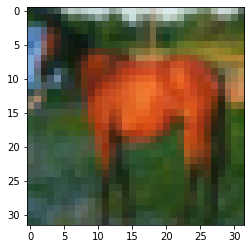

In [ ]:
plt.imshow(test_rgb[6,:,:,:].transpose((1,2,0)))

(1, 32, 32)
(2, 32, 32)
(3, 32, 32)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 6 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


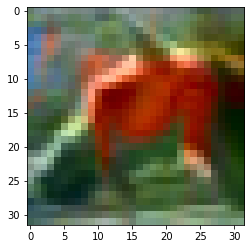

In [ ]:
labimg0=rgb2normLab(test_rgb[6,:,:,:],transp=66)
ab0=ab(labimg0)
L1=test_grey[2,:,:,:]
print(L1.shape)
print(ab0.shape)
labimg10=catL2ab(L1,ab0)
print(labimg10.shape)
showNormLab(labimg10.transpose(1,2,0),transp=0)
#try mount the color (ab) channels of one image onto another image's brightness (L) channel

In [ ]:
(x_train, y_train), (x_test, y_test) = load_cifar10()
train_rgb, train_grey = process(x_train, y_train, downsize_input=False)
test_rgb, test_grey = process(x_test, y_test, downsize_input=False)
train_Lab=batch_rgb2normlab(train_rgb)
test_Lab=batch_rgb2normlab(test_rgb)
for i, (xs, ys) in enumerate(get_batch(train_grey, train_rgb, 2)):
            images, labels = get_torch_vars(xs, ys, True)
            print(images.shape)
            break

File path: data/cifar-10-batches-py.tar.gz
torch.Size([2, 1, 32, 32])


In [ ]:
train_ab=train_Lab[:,1:3,:,:]
test_ab=test_Lab[:,1:3,:,:]
train_ab.shape 

(5000, 2, 32, 32)

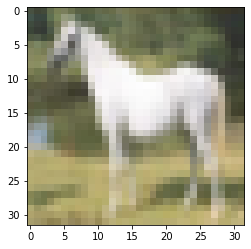

In [ ]:
showNormLab(train_Lab[4,:,:,:])

In [ ]:
# visualize 5 train/test images
def visualLab(img_grey, img_real, img_fake, gpu = 0, flag_torch = 0):

  if gpu:
    img_grey = img_grey.cpu().detach().numpy()
    img_real = img_real.cpu().detach().numpy()
    img_fake = img_fake.cpu().detach().numpy()

  #correct image structure
  img_grey = np.transpose(img_grey[:5, :, :, :], [0, 1,2,3]) #greyscale
  img_real = np.transpose(img_real[:5, :, :, :], [0, 1,2,3]) #2 channels a and b
  img_fake = np.transpose(img_fake[:5, :, :, :], [0, 1,2,3]) #2 channels a and b

  for i in range(5):
      #ax = plt.subplot(1, 5, i + 1)
      #ax.imshow(img_grey[i].transpose([1,2,0]).squeeze(), cmap='gray')
      #ax.axis("off")
      plt.subplot(2, 5, i + 1 )
      #print(img_grey[i].shape)
      showNormLab(catL2ab(img_grey[i],img_real[i]),transp=1) #combine L and ab, then show
      plt.axis("off")
      plt.subplot(2, 5, i + 1 + 5)
      showNormLab(catL2ab(img_grey[i],img_fake[i]),transp=1)
      plt.axis("off")
  plt.show()

In [ ]:
# now the generator intakes the grey image and predicts the two channels a and b
# the discriminator will intake channels a and b and compare them with the greyscale image, the structure is the same as the previous one
gensizes=[]
class Generator_Lab(nn.Module):
    def __init__(self, kernel, num_filters, num_in_channels=1):
        super().__init__()

        # Useful parameters
        stride = 2
        padding = kernel // 2
        output_padding = 1
        padding = kernel // 2

        self.downconv1 = nn.Sequential(
            nn.Conv2d(1, num_filters, kernel_size=kernel, padding=padding),
            nn.BatchNorm2d(num_filters),
            nn.LeakyReLU(0.2,inplace=True),
            nn.MaxPool2d(2),)
        self.downconv2 = nn.Sequential(
            nn.Conv2d(num_filters, num_filters*2, kernel_size=kernel, padding=padding),
            nn.BatchNorm2d(num_filters*2),
            nn.LeakyReLU(0.2,inplace=True),
            nn.MaxPool2d(2),)

        self.rfconv = nn.Sequential(
            nn.Conv2d(num_filters*2, num_filters*2, kernel_size=kernel, padding=padding),
            nn.BatchNorm2d(num_filters*2),
            nn.LeakyReLU(0.2,inplace=True))

        self.upconv1 = nn.Sequential(
            nn.Conv2d(num_filters*4, num_filters, kernel_size=kernel, padding=padding),
            nn.BatchNorm2d(num_filters),
            nn.LeakyReLU(0.2,inplace=True),
            nn.Upsample(scale_factor=2),)
        self.upconv2 = nn.Sequential(
            nn.Conv2d(num_filters*2, 2, kernel_size=kernel, padding=padding),
            nn.BatchNorm2d(2),
            nn.LeakyReLU(0.2,inplace=True),
            nn.Upsample(scale_factor=2),)
        self.finalconv = nn.Conv2d(3, 2, kernel_size=kernel, padding=padding)

    def forward(self, x):
        global gensizes
        gensizes=[]
        gensizes.append(x.size())
        lay1 = self.downconv1(x)
        gensizes.append(lay1.size())
        lay2 = self.downconv2(lay1)
        gensizes.append(lay2.size())
        lay3 = self.rfconv(lay2)
        lay3=torch.cat((lay3,lay2),1)
        gensizes.append(lay3.size())
        lay4 = self.upconv1(lay3)
        lay4=torch.cat((lay4,lay1),1)
        gensizes.append(lay4.size())
        lay5 = self.upconv2(lay4)
        lay5=torch.cat((lay5,x),1)
        gensizes.append(lay5.size())
        out = self.finalconv(lay5)
        gensizes.append(out.size())
        return out

In [ ]:
trygen=Generator_Lab(3,16)
rt=torch.rand([2,1,32,32])
grt=trygen(rt)
grt.shape

torch.Size([2, 2, 32, 32])

Loading data...
Transforming data...
will create the outputs folder...
Beginning training ...
0 tensor(2.0273) tensor(0.8220)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 2 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 1 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 7 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


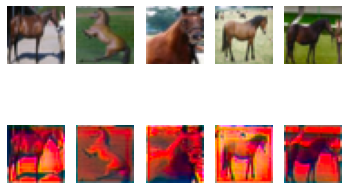

1 tensor(1.4968) tensor(0.9954)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 324 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 384 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 432 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 114 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 449 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


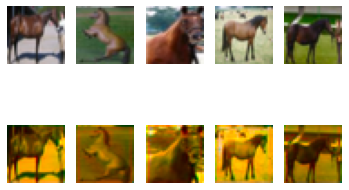

2 tensor(0.6759) tensor(1.3772)


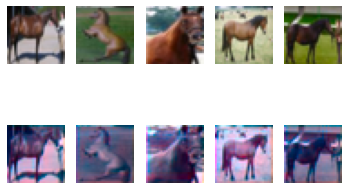

3 tensor(0.9142) tensor(1.3690)


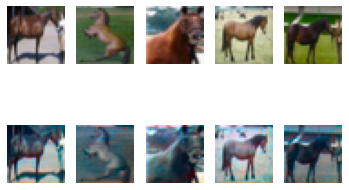

4 tensor(0.6999) tensor(1.4691)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 3 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 13 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


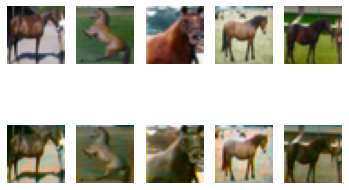

5 tensor(0.6836) tensor(1.4070)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 100 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 57 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 63 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 22 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 118 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


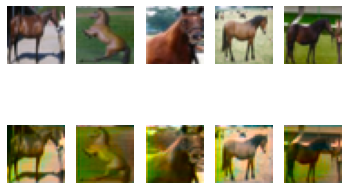

6 tensor(0.7215) tensor(1.3917)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 33 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


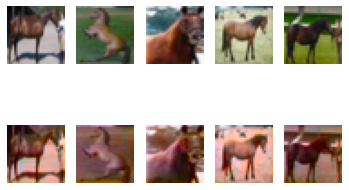

7 tensor(0.7321) tensor(1.3720)


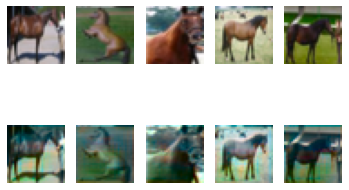

8 tensor(0.7388) tensor(1.3938)


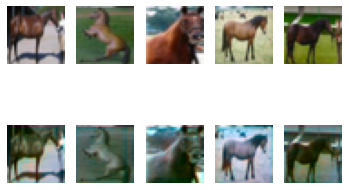

9 tensor(0.6856) tensor(1.3637)


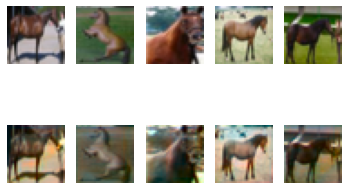

10 tensor(0.7300) tensor(1.4378)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 41 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 5 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 97 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 88 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


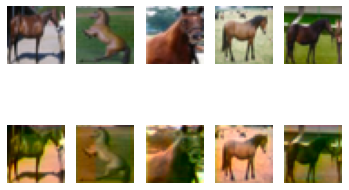

11 tensor(0.7765) tensor(1.3743)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 149 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 15 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 210 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 20 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 246 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


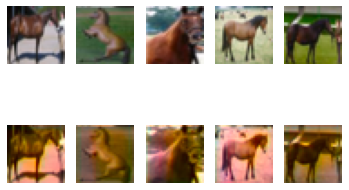

12 tensor(0.7843) tensor(1.4430)


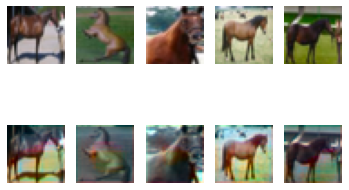

13 tensor(0.7747) tensor(1.2349)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 4 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 24 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


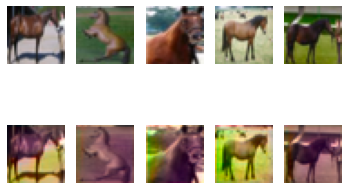

14 tensor(0.7134) tensor(1.2572)


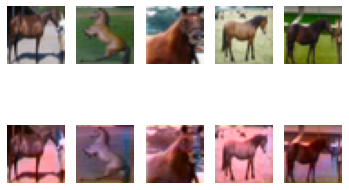

15 tensor(0.7694) tensor(1.4035)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 6 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 9 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


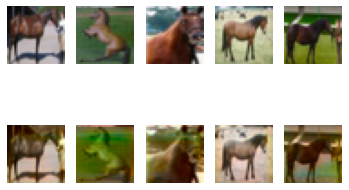

16 tensor(0.7157) tensor(1.3998)


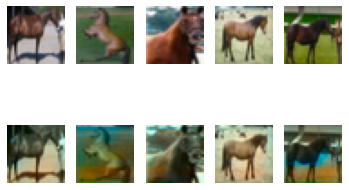

17 tensor(0.7995) tensor(1.4013)


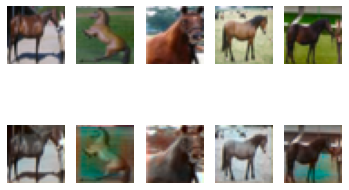

18 tensor(0.7147) tensor(1.3783)


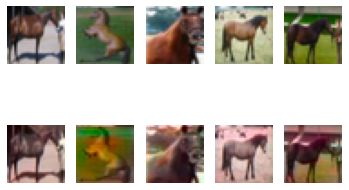

19 tensor(0.6556) tensor(1.4069)


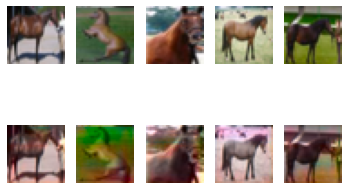

20 tensor(0.6717) tensor(1.4223)


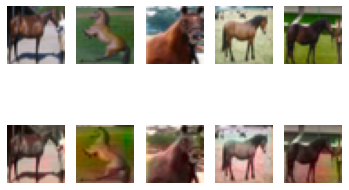

21 tensor(0.7266) tensor(1.3597)


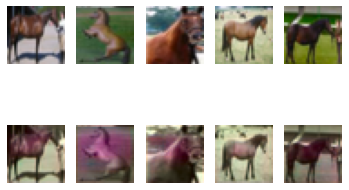

22 tensor(0.8725) tensor(1.3875)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 189 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 18 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


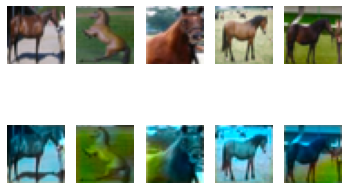

23 tensor(0.7165) tensor(1.2072)


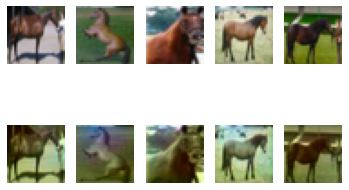

24 tensor(0.9056) tensor(1.2795)


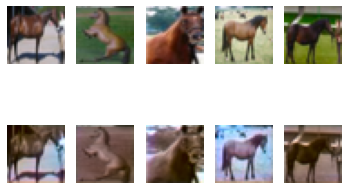

25 tensor(0.7685) tensor(1.3312)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 101 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


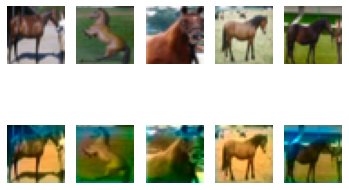

26 tensor(0.8048) tensor(1.2849)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 8 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


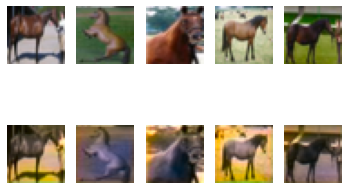

27 tensor(0.7596) tensor(1.4263)


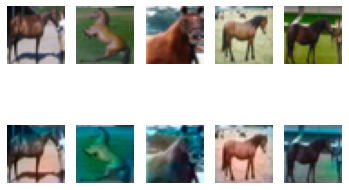

28 tensor(0.6934) tensor(1.3407)


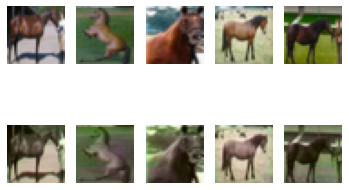

29 tensor(0.7828) tensor(1.3312)


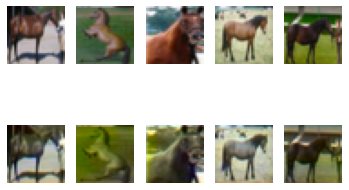

30 tensor(0.7277) tensor(1.3495)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 12 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 127 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 31 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


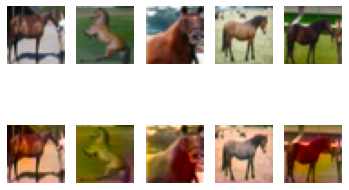

31 tensor(0.6860) tensor(1.3967)


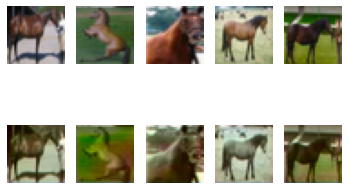

32 tensor(0.7154) tensor(1.3607)


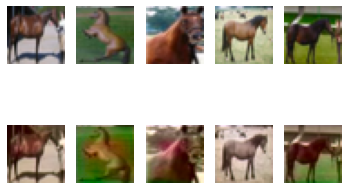

33 tensor(0.7624) tensor(1.3571)


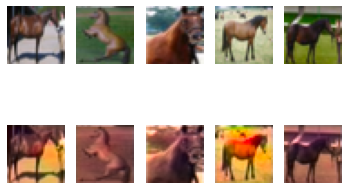

34 tensor(0.7289) tensor(1.4690)


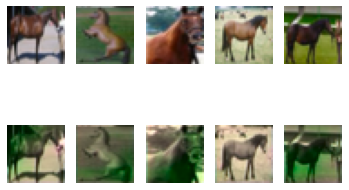

35 tensor(0.7743) tensor(1.3957)


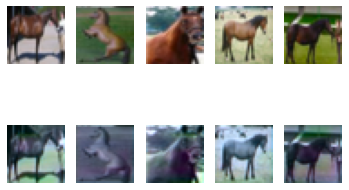

36 tensor(0.7284) tensor(1.4510)


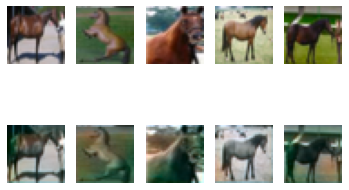

37 tensor(0.7816) tensor(1.3236)


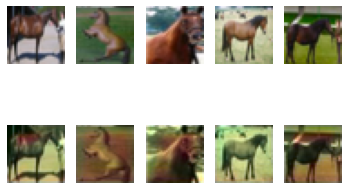

38 tensor(0.7272) tensor(1.3689)


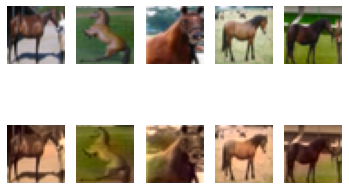

39 tensor(0.7412) tensor(1.3748)


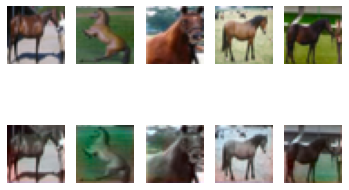

40 tensor(0.7132) tensor(1.3587)


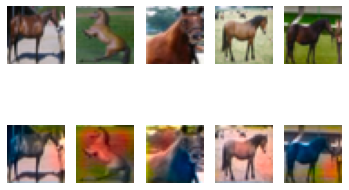

41 tensor(0.6859) tensor(1.3041)


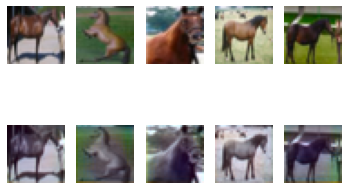

42 tensor(0.8345) tensor(1.3876)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 17 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


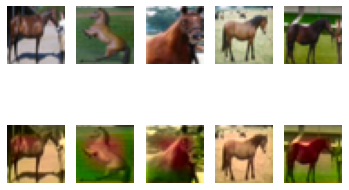

43 tensor(0.9806) tensor(1.1860)


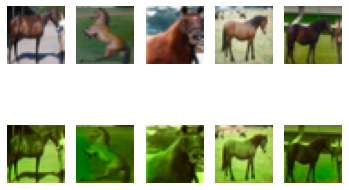

44 tensor(1.1310) tensor(1.0681)


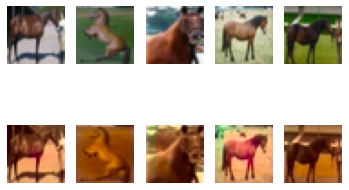

45 tensor(0.8362) tensor(1.2850)


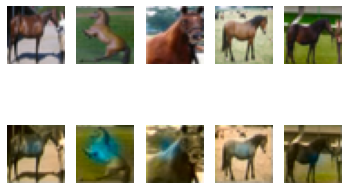

46 tensor(0.8270) tensor(1.3262)


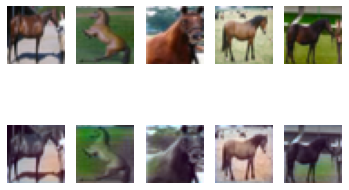

47 tensor(0.7920) tensor(1.2921)


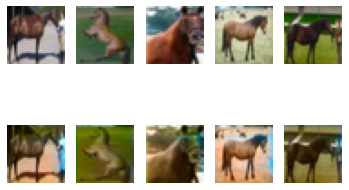

48 tensor(0.9432) tensor(1.2681)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 26 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


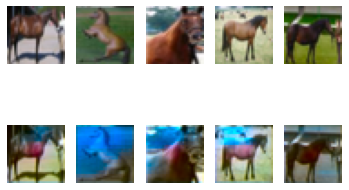

49 tensor(0.8980) tensor(1.1970)


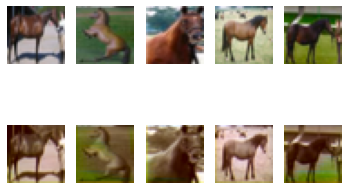

50 tensor(0.9936) tensor(1.3321)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 52 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


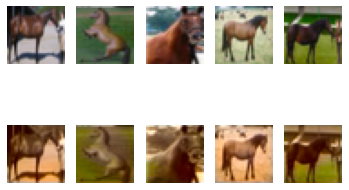

51 tensor(1.0582) tensor(1.0843)


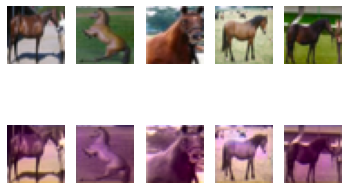

52 tensor(1.2514) tensor(0.9375)


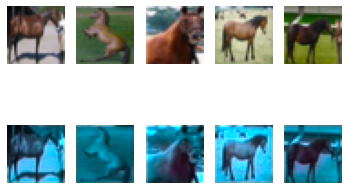

53 tensor(0.9507) tensor(1.0973)


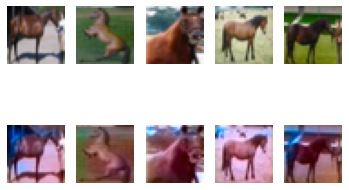

54 tensor(0.9960) tensor(1.1541)


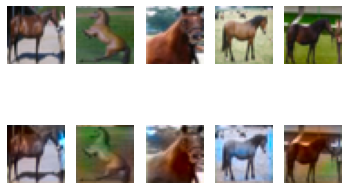

55 tensor(0.9654) tensor(1.2325)


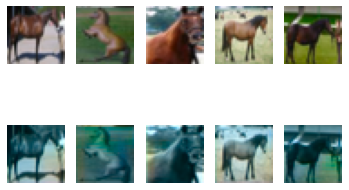

56 tensor(0.9580) tensor(1.2705)


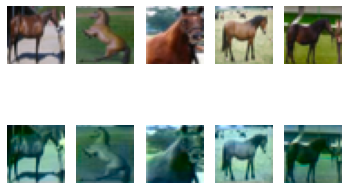

57 tensor(0.9835) tensor(1.2614)


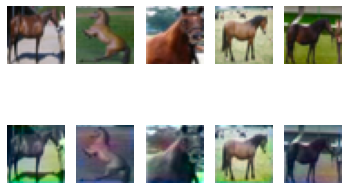

58 tensor(0.9844) tensor(1.1833)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 120 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 99 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


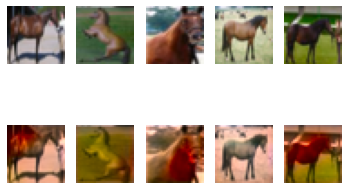

59 tensor(0.9070) tensor(1.2888)


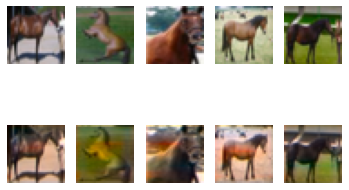

60 tensor(0.8409) tensor(1.3681)


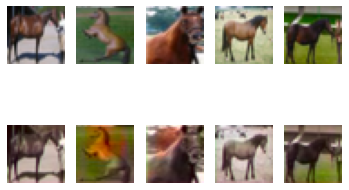

61 tensor(0.8010) tensor(1.2894)


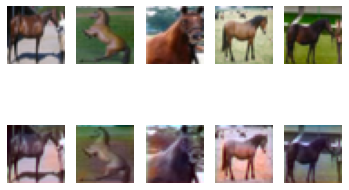

62 tensor(0.8511) tensor(1.4190)


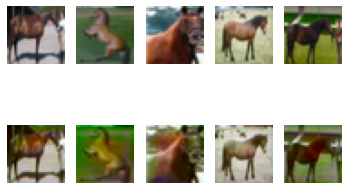

63 tensor(0.8214) tensor(1.4707)


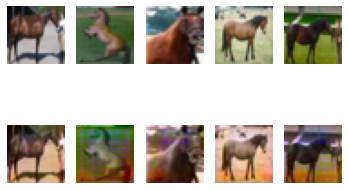

64 tensor(0.8655) tensor(1.2357)


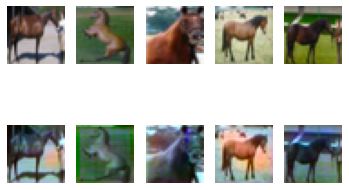

65 tensor(0.9121) tensor(1.2283)


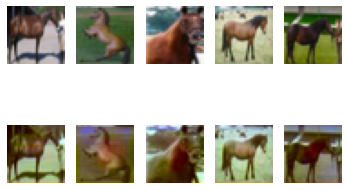

66 tensor(0.8821) tensor(1.0962)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 91 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 77 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 32 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


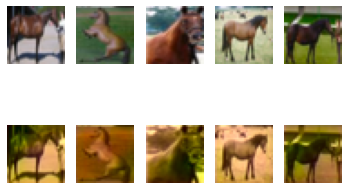

67 tensor(0.8843) tensor(1.4613)


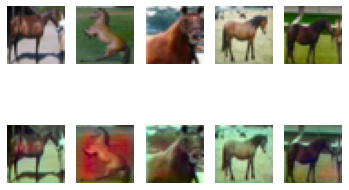

68 tensor(0.8762) tensor(1.3006)


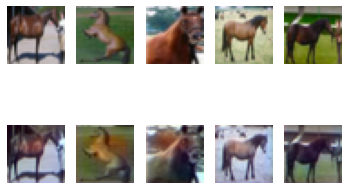

69 tensor(0.7566) tensor(1.3630)


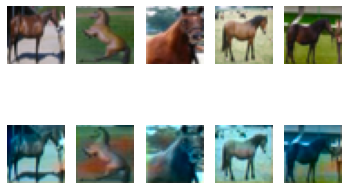

70 tensor(0.8025) tensor(1.2701)


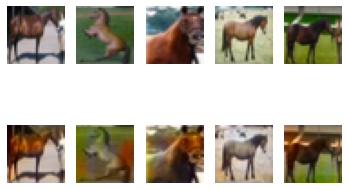

71 tensor(0.7335) tensor(1.4385)


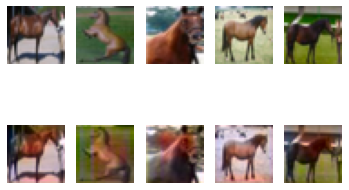

72 tensor(0.8199) tensor(1.3446)


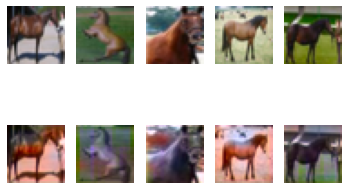

73 tensor(1.0048) tensor(1.2650)


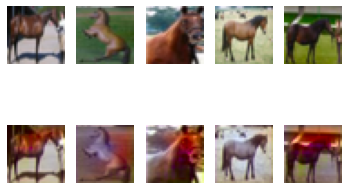

74 tensor(0.9805) tensor(1.3093)


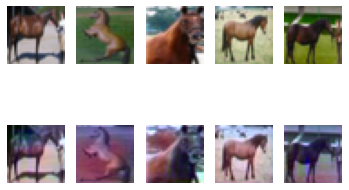

75 tensor(0.7926) tensor(1.2356)


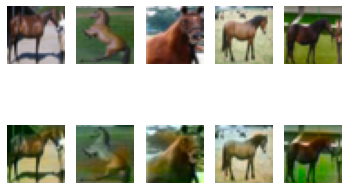

76 tensor(0.7867) tensor(1.3622)


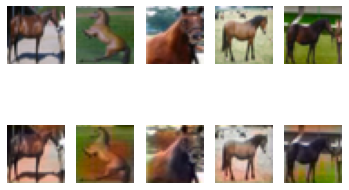

77 tensor(0.7928) tensor(1.3486)


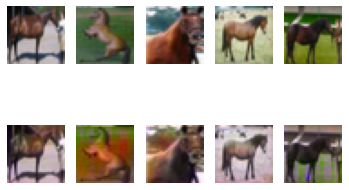

78 tensor(0.7988) tensor(1.3386)


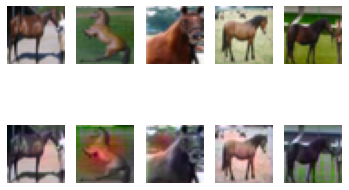

79 tensor(0.7886) tensor(1.3718)


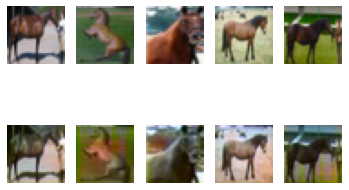

80 tensor(0.9403) tensor(1.3306)


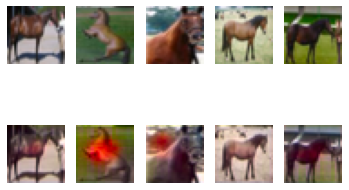

81 tensor(0.9051) tensor(1.3121)


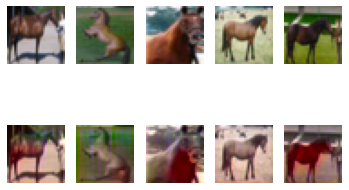

82 tensor(0.8589) tensor(1.2167)


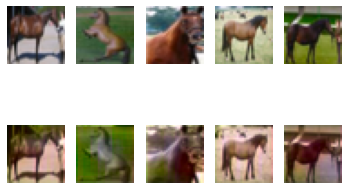

83 tensor(0.8323) tensor(1.3459)


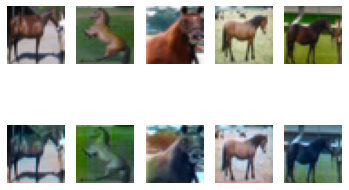

84 tensor(0.7747) tensor(1.3384)


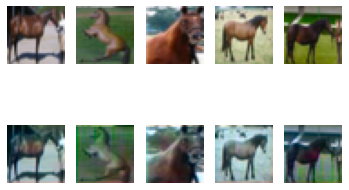

85 tensor(0.8737) tensor(1.3009)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 75 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


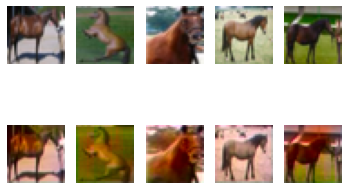

86 tensor(0.8983) tensor(1.2791)


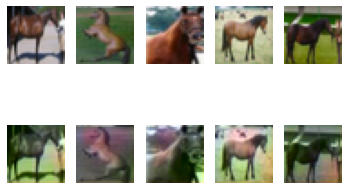

87 tensor(0.9684) tensor(1.1524)


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 54 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 65 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


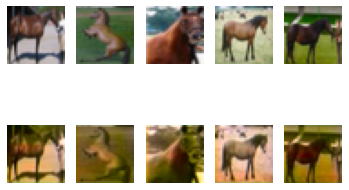

88 tensor(0.8010) tensor(1.5604)


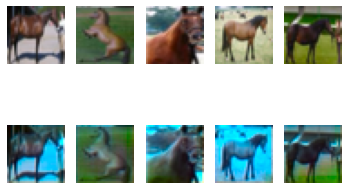

89 tensor(0.8214) tensor(1.3324)


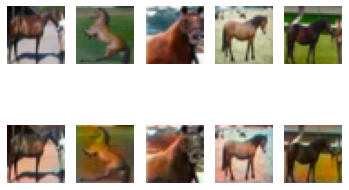

90 tensor(0.8418) tensor(1.2275)


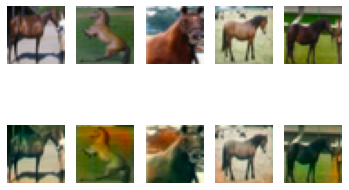

91 tensor(0.7895) tensor(1.3879)


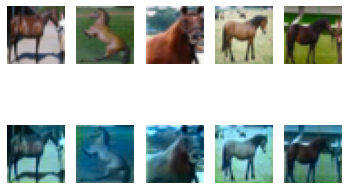

92 tensor(0.9447) tensor(1.2168)


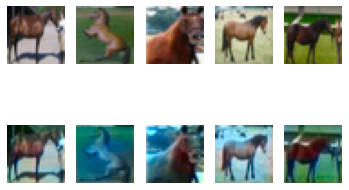

93 tensor(0.8167) tensor(1.2626)


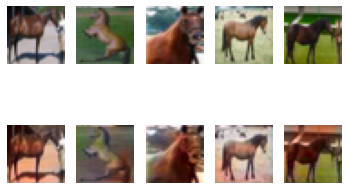

94 tensor(0.7969) tensor(1.3257)


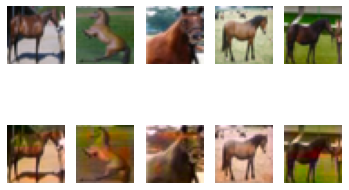

95 tensor(0.9831) tensor(1.2415)


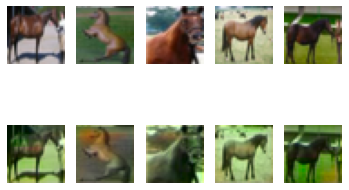

96 tensor(0.7686) tensor(1.3053)


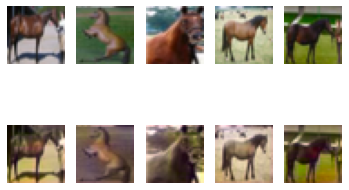

97 tensor(0.9818) tensor(1.1910)


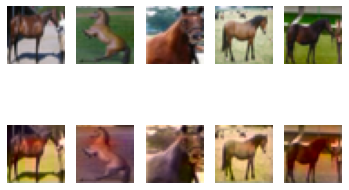

98 tensor(0.8321) tensor(1.2947)


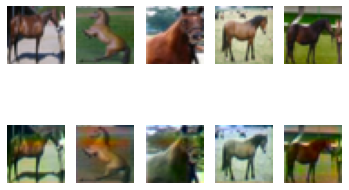

99 tensor(0.8841) tensor(1.2252)


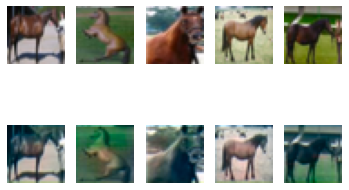

In [ ]:
#CUDA_LAUNCH_BLOCKING=1 python script.py
#train_rgb=train_ab
args = AttrDict()
args_dict = {
    "gpu": True,
    "valid": False,
    "checkpoint": "",
    "colours": "",
    "num_colours":2,
    "model": "Generator_Lab",
    "kernel": 3,
    "num_filters": 16,
    'learn_rate':0.001,
    'learn_rate_ratio':5, 
    "batch_size": 50,
    "epochs": 100,
    "seed": 0,
    "plot": False,
    "experiment_name": "colourization_cnn",
    "visualize": False,
    "downsize_input": False,
}
args.update(args_dict)
cnn = train(args,train_grey=train_grey,train_rgb=train_ab)

#batch size of 50 with 100 epochs seemed to work

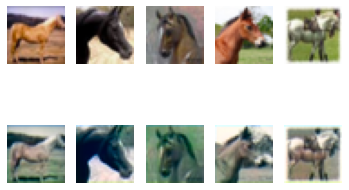

In [ ]:
testdexs=np.random.randint(1000,size=5)
tests=torch.from_numpy(test_grey)[testdexs,:,:,:].float().cuda()
preds=cnn(tests)
for i in range(preds.size()[0]):
  predimg=preds[i,:,:,:].squeeze().detach().cpu().numpy()
  L=tests[i,:,:,:].squeeze().detach().cpu().numpy()
  plt.subplot(2,preds.size()[0],i+1+preds.size()[0])
  showNormLab(catL2ab((L,),predimg))
  plt.axis("off")
  origimg=test_ab[testdexs[i],:,:,:].squeeze()
  plt.subplot(2,preds.size()[0],i+1)
  showNormLab(catL2ab((L,),origimg))
  plt.axis("off")

the Lab colorspace makes the cGAN work slightly better than with RGB colorspace. The colors seem to be slightly more realistic and there are no unwanted brightness gradients. This is because the brightness is locked with the Lab encoding.

## Part 3. New Data
Retrieve sample pictures from online and demonstrate how well the best model performs.

In [ ]:
from google.colab import files
uploaded=files.upload()

Saving horsimgs.zip to horsimgs.zip


In [ ]:
from zipfile import ZipFile
with ZipFile('horsimgs.zip','r') as zipper:
  zipper.extractall()

In [ ]:
from skimage import io
oltestset=np.zeros([10,3,32,32])
for i in range(1,11):
  try:
    fname=str(i)+'rgb.jpg'
    oltestset[i-1,:,:,:]=io.imread(fname).transpose(2,0,1)
  except:
    fname=str(i)+'rgb.jpeg'
    oltestset[i-1,:,:,:]=io.imread(fname).transpose(2,0,1)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


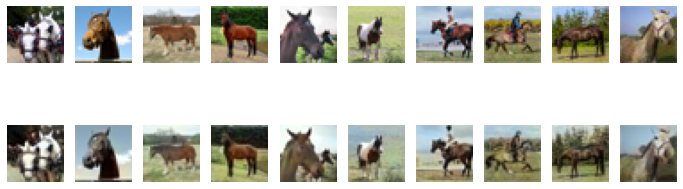

In [ ]:
# provide your code here
oltest_gray=torch.from_numpy(np.mean(oltestset, axis=1, keepdims=True)/256).float()
oltest_rgb=torch.from_numpy(oltestset/256).float()
un6.cuda()
preds=un6(oltest_gray.cuda())
plt.figure(figsize=[12,4])
for i in range(preds.size()[0]):
  predimg=preds[i,:,:,:].squeeze().detach().cpu().numpy()
  predimg=predimg.transpose(1,2,0)
  plt.subplot(2,preds.size()[0],i+1+preds.size()[0])
  plt.imshow(predimg)
  plt.axis('off')
  origimg=oltest_rgb[i,:,:,:].squeeze()
  origimg=origimg.detach().cpu().numpy().transpose(1,2,0)
  plt.subplot(2,preds.size()[0],i+1)
  plt.imshow(origimg)
  plt.axis('off')

The best model is the UNet model. This model works pretty well. The colors look real and comfortable. The colored images can hardly be distinguished from the original color images.